<center> <img src = https://raw.githubusercontent.com/AndreyRysistov/DatasetsForPandas/main/hh%20label.jpg alt="drawing" style="width:400px;">

# <center> Проект: Анализ вакансий на hh.ru
   

In [79]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# Исследование структуры данных

1. Прочитайте данные с помощью библиотеки Pandas. Совет: перед чтением обратите внимание на разделитель внутри файла. 

In [80]:
# выведу загрузку таблицы отдельным кодом, чтобы не счиатывать заного при каждом подэтапе проекта
hh_data = pd.read_csv('data/dst-3.0_16_1_hh_database.csv', sep=';')  #разделитель точка с запятой
print(f'размерность таблицы (строки, столбцы):{hh_data.shape}') # выведем сразу еще размерность таблицы


размерность таблицы (строки, столбцы):(44744, 12)


2. Выведите несколько первых (последних) строк таблицы, чтобы убедиться в том, что ваши данные не повреждены. Ознакомьтесь с признаками и их структурой.

In [81]:
#ваш код здесь
display(hh_data.head()) # выведем первые строки, чтобы посмотреть на данные


,"Пол, возраст",ЗП,Ищет работу на должность:,"Город, переезд, командировки",Занятость,График,Опыт работы,Последнее/нынешнее место работы,Последняя/нынешняя должность,Образование и ВУЗ,Обновление резюме,Авто
0,"Мужчина , 39 лет , родился 27 ноября 1979",29000 руб.,Системный администратор,"Советск (Калининградская область) , не готов к...","частичная занятость, проектная работа, полная ...","гибкий график, полный день, сменный график, ва...",Опыт работы 16 лет 10 месяцев Август 2010 — п...,"МАОУ ""СОШ № 1 г.Немана""",Системный администратор,Неоконченное высшее образование 2000 Балтийск...,16.04.2019 15:59,Имеется собственный автомобиль
1,"Мужчина , 60 лет , родился 20 марта 1959",40000 руб.,Технический писатель,"Королев , не готов к переезду , готов к редким...","частичная занятость, проектная работа, полная ...","гибкий график, полный день, сменный график, уд...",Опыт работы 19 лет 5 месяцев Январь 2000 — по...,Временный трудовой коллектив,"Менеджер проекта, Аналитик, Технический писатель",Высшее образование 1981 Военно-космическая ак...,12.04.2019 08:42,Не указано
2,"Женщина , 36 лет , родилась 12 августа 1982",20000 руб.,Оператор,"Тверь , не готова к переезду , не готова к ком...",полная занятость,полный день,Опыт работы 10 лет 3 месяца Октябрь 2004 — Де...,ПАО Сбербанк,Кассир-операционист,Среднее специальное образование 2002 Профессио...,16.04.2019 08:35,Не указано
3,"Мужчина , 38 лет , родился 25 июня 1980",100000 руб.,Веб-разработчик (HTML / CSS / JS / PHP / базы ...,"Саратов , не готов к переезду , готов к редким...","частичная занятость, проектная работа, полная ...","гибкий график, удаленная работа",Опыт работы 18 лет 9 месяцев Август 2017 — Ап...,OpenSoft,Инженер-программист,Высшее образование 2002 Саратовский государст...,08.04.2019 14:23,Не указано
4,"Женщина , 26 лет , родилась 3 марта 1993",140000 руб.,Региональный менеджер по продажам,"Москва , не готова к переезду , готова к коман...",полная занятость,полный день,Опыт работы 5 лет 7 месяцев Региональный мене...,Мармелад,Менеджер по продажам,Высшее образование 2015 Кгу Психологии и педаг...,22.04.2019 10:32,Не указано


3. Выведите основную информацию о числе непустых значений в столбцах и их типах в таблице.

4. Обратите внимание на информацию о числе непустых значений.

In [82]:
#ваш код здесь
display(hh_data.info()) # выведем общую информацию о столбцах, их типах и количествах пустых мест

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 44744 entries, 0 to 44743
Data columns (total 12 columns):
 #   Column                           Non-Null Count  Dtype 
---  ------                           --------------  ----- 
 0   Пол, возраст                     44744 non-null  object
 1   ЗП                               44744 non-null  object
 2   Ищет работу на должность:        44744 non-null  object
 3   Город, переезд, командировки     44744 non-null  object
 4   Занятость                        44744 non-null  object
 5   График                           44744 non-null  object
 6   Опыт работы                      44576 non-null  object
 7   Последнее/нынешнее место работы  44743 non-null  object
 8   Последняя/нынешняя должность     44742 non-null  object
 9   Образование и ВУЗ                44744 non-null  object
 10  Обновление резюме                44744 non-null  object
 11  Авто                             44744 non-null  object
dtypes: object(12)
memory usage: 4.1+

None

Видим, что столбцы "Опыт работы", "Последнее/нынешнее место работы" и "Последняя/нынешняя должность" содержат пустые значения

5. Выведите основную статистическую информацию о столбцах.


In [83]:
#ваш код здесь
display(hh_data.describe(include=['object'])) #выведем описательную статистику по типу object

,"Пол, возраст",ЗП,Ищет работу на должность:,"Город, переезд, командировки",Занятость,График,Опыт работы,Последнее/нынешнее место работы,Последняя/нынешняя должность,Образование и ВУЗ,Обновление резюме,Авто
count,44744,44744,44744,44744,44744,44744,44576,44743,44742,44744,44744,44744
unique,16003,690,14929,10063,38,47,44413,30214,16927,40148,18838,2
top,"Мужчина , 32 года , родился 17 сентября 1986",50000 руб.,Системный администратор,"Москва , не готов к переезду , не готов к кома...",полная занятость,полный день,Опыт работы 10 лет 8 месяцев Апрель 2018 — по...,Индивидуальное предпринимательство / частная п...,Системный администратор,Высшее образование 1987 Военный инженерный Кра...,07.05.2019 09:50,Не указано
freq,18,4064,3099,1261,30026,22727,3,935,2062,4,25,32268


# Преобразование данных

1. Начнем с простого - с признака **"Образование и ВУЗ"**. Его текущий формат это: **<Уровень образования год выпуска ВУЗ специальность...>**. Например:
* Высшее образование 2016 Московский авиационный институт (национальный исследовательский университет)...
* Неоконченное высшее образование 2000  Балтийская государственная академия рыбопромыслового флота…
Нас будет интересовать только уровень образования.

Создайте с помощью функции-преобразования новый признак **"Образование"**, который должен иметь 4 категории: "высшее", "неоконченное высшее", "среднее специальное" и "среднее".

Выполните преобразование, ответьте на контрольные вопросы и удалите признак "Образование и ВУЗ".

Совет: обратите внимание на структуру текста в столбце **"Образование и ВУЗ"**. Гарантируется, что текущий уровень образования соискателя всегда находится в первых 2ух слов и начинается с заглавной буквы. Воспользуйтесь этим.

*Совет: проверяйте полученные категории, например, с помощью метода unique()*


In [84]:
#ваш код здесь
# зададим функцию, которая по строке выделет категрии уровня образования
def get_education_level(s):  #s - строка соответвующая правилам, что первые ее слова - 
    #это "высшее", "неоконченное высшее", "среднее специальное" и "среднее".
    s = s.lower()
    word_list = s.split()
    if word_list[1] in ['высшее','специальное']:
        return word_list[0]+' '+word_list[1]
    elif word_list[0] in ['высшее','среднее']: #не стал писать else чтобы если где-то форма фраз нарушена, чтобы функция вывела пусто 
        return word_list[0]
    
hh_data['Образование'] = hh_data['Образование и ВУЗ'].apply(get_education_level) #применим функцию выделения Образования к столбцу "Оразование и ВУЗ"

print( f"Всего строк с коректно определенным образованием {hh_data['Образование'].value_counts().sum()}") 
display(hh_data['Образование'].value_counts())

hh_data = hh_data.drop('Образование и ВУЗ', axis=1) # удалим ненужный столбец
display(hh_data.head(2))



Всего строк с коректно определенным образованием 44744


высшее                 33863
среднее специальное     5765
неоконченное высшее     4557
среднее                  559
Name: Образование, dtype: int64

,"Пол, возраст",ЗП,Ищет работу на должность:,"Город, переезд, командировки",Занятость,График,Опыт работы,Последнее/нынешнее место работы,Последняя/нынешняя должность,Обновление резюме,Авто,Образование
0,"Мужчина , 39 лет , родился 27 ноября 1979",29000 руб.,Системный администратор,"Советск (Калининградская область) , не готов к...","частичная занятость, проектная работа, полная ...","гибкий график, полный день, сменный график, ва...",Опыт работы 16 лет 10 месяцев Август 2010 — п...,"МАОУ ""СОШ № 1 г.Немана""",Системный администратор,16.04.2019 15:59,Имеется собственный автомобиль,неоконченное высшее
1,"Мужчина , 60 лет , родился 20 марта 1959",40000 руб.,Технический писатель,"Королев , не готов к переезду , готов к редким...","частичная занятость, проектная работа, полная ...","гибкий график, полный день, сменный график, уд...",Опыт работы 19 лет 5 месяцев Январь 2000 — по...,Временный трудовой коллектив,"Менеджер проекта, Аналитик, Технический писатель",12.04.2019 08:42,Не указано,высшее


2. Теперь нас интересует столбец **"Пол, возраст"**. Сейчас он представлен в формате **<Пол , возраст , дата рождения >**. Например:
* Мужчина , 39 лет , родился 27 ноября 1979 
* Женщина , 21 год , родилась 13 января 2000
Как вы понимаете, нам необходимо выделить каждый параметр в отдельный столбец.

Создайте два новых признака **"Пол"** и **"Возраст"**. При этом важно учесть:
* Признак пола должен иметь 2 уникальных строковых значения: 'М' - мужчина, 'Ж' - женщина. 
* Признак возраста должен быть представлен целыми числами.

Выполните преобразование, ответьте на контрольные вопросы и удалите признак **"Пол, возраст"** из таблицы.

*Совет: обратите внимание на структуру текста в столбце, в части на то, как разделены параметры пола, возраста и даты рождения между собой - символом ' , '. 
Гарантируется, что структура одинакова для всех строк в таблице. Вы можете воспользоваться этим.*


In [85]:
#ваш код здесь
from locale import normalize


hh_data['Пол'] = hh_data['Пол, возраст'].apply(lambda x: x[0]) #СОздадим столбец- первая буква столбца "Пол, возраст". Это и будет пол
hh_data['Возраст'] = hh_data['Пол, возраст'].apply(lambda x: int(x.split(sep=',')[1].split()[0])) # идея такая: разбиваем по запятым строку. Второе слово начинается с возраста и он отделет пробелом. Разбиваем слово снова на списко по пробелам и берем первое слово. Это возраст. Сейчас он текст, превращаем в число

display(hh_data.head(3))
display(hh_data['Пол'].value_counts(normalize= True)) # выведем долю М и Ж с помощью параметра normalize метода value_counts
display(hh_data['Возраст'].mean()) #выведем средний возраст

hh_data = hh_data.drop('Пол, возраст', axis=1) # удалим ненужный столбец



,"Пол, возраст",ЗП,Ищет работу на должность:,"Город, переезд, командировки",Занятость,График,Опыт работы,Последнее/нынешнее место работы,Последняя/нынешняя должность,Обновление резюме,Авто,Образование,Пол,Возраст
0,"Мужчина , 39 лет , родился 27 ноября 1979",29000 руб.,Системный администратор,"Советск (Калининградская область) , не готов к...","частичная занятость, проектная работа, полная ...","гибкий график, полный день, сменный график, ва...",Опыт работы 16 лет 10 месяцев Август 2010 — п...,"МАОУ ""СОШ № 1 г.Немана""",Системный администратор,16.04.2019 15:59,Имеется собственный автомобиль,неоконченное высшее,М,39
1,"Мужчина , 60 лет , родился 20 марта 1959",40000 руб.,Технический писатель,"Королев , не готов к переезду , готов к редким...","частичная занятость, проектная работа, полная ...","гибкий график, полный день, сменный график, уд...",Опыт работы 19 лет 5 месяцев Январь 2000 — по...,Временный трудовой коллектив,"Менеджер проекта, Аналитик, Технический писатель",12.04.2019 08:42,Не указано,высшее,М,60
2,"Женщина , 36 лет , родилась 12 августа 1982",20000 руб.,Оператор,"Тверь , не готова к переезду , не готова к ком...",полная занятость,полный день,Опыт работы 10 лет 3 месяца Октябрь 2004 — Де...,ПАО Сбербанк,Кассир-операционист,16.04.2019 08:35,Не указано,среднее специальное,Ж,36


М    0.809293
Ж    0.190707
Name: Пол, dtype: float64

32.19674146254246

3. Следующим этапом преобразуем признак **"Опыт работы"**. Его текущий формат - это: **<Опыт работы: n лет m месяцев, периоды работы в различных компаниях…>**. 

Из столбца нам необходимо выделить общий опыт работы соискателя в месяцах, новый признак назовем "Опыт работы (месяц)"

Для начала обсудим условия решения задачи:
* Во-первых, в данном признаке есть пропуски. Условимся, что если мы встречаем пропуск, оставляем его как есть (функция-преобразование возвращает NaN)
* Во-вторых, в данном признаке есть скрытые пропуски. Для некоторых соискателей в столбце стоит значения "Не указано". Их тоже обозначим как NaN (функция-преобразование возвращает NaN)
* В-третьих, нас не интересует информация, которая описывается после указания опыта работы (периоды работы в различных компаниях)
* В-четвертых, у нас есть проблема: опыт работы может быть представлен только в годах или только месяцах. Например, можно встретить следующие варианты:
    * Опыт работы 3 года 2 месяца…
    * Опыт работы 4 года…
    * Опыт работы 11 месяцев…
    * Учитывайте эту особенность в вашем коде

Учитывайте эту особенность в вашем коде

В результате преобразования у вас должен получиться столбец, содержащий информацию о том, сколько месяцев проработал соискатель.
Выполните преобразование, ответьте на контрольные вопросы и удалите столбец **"Опыт работы"** из таблицы.


In [86]:
#ваш код здесь

from cmath import nan

# создадим функцию, которая будет нам выдавать число месяцев работы.
def get_work_exp_month_count(s): 
    if s is np.nan: return np.nan # возвращаем NaN для отсутствующих значений
    s = s.split() 
    month_res = 0 # результирующее число месяцев работы
    if len(s)<=3: return np.nan # Возвращаем NaN для значений где недостаточно слов в строке, чтобы быть полням описанием
    if s[3] in ['лет','год','года']: month_res += int(s[2])*12
    if s[5] in ['месяц','месяца','месяцев']: month_res += int(s[4])
    return month_res
   
hh_data['Опыт работы (месяц)'] = hh_data['Опыт работы'].apply(get_work_exp_month_count)
display(hh_data['Опыт работы (месяц)'].median()) #выведем медианный оыт для задания-вопроса
hh_data = hh_data.drop('Опыт работы', axis=1) # удалим ненужный столбец



100.0

4. Хорошо идем! Следующий на очереди признак "Город, переезд, командировки". Информация в нем представлена в следующем виде: **<Город , (метро) , готовность к переезду (города для переезда) , готовность к командировкам>**. В скобках указаны необязательные параметры строки. Например, можно встретить следующие варианты:

* Москва , не готов к переезду , готов к командировкам
* Москва , м. Беломорская , не готов к переезду, не готов к командировкам
* Воронеж , готов к переезду (Сочи, Москва, Санкт-Петербург) , готов к командировкам

Создадим отдельные признаки **"Город"**, **"Готовность к переезду"**, **"Готовность к командировкам"**. При этом важно учесть:

* Признак **"Город"** должен содержать только 4 категории: "Москва", "Санкт-Петербург" и "город-миллионник" (их список ниже), остальные обозначьте как "другие".

    Список городов-миллионников:
    
   <code>million_cities = ['Новосибирск', 'Екатеринбург','Нижний Новгород','Казань', 'Челябинск','Омск', 'Самара', 'Ростов-на-Дону', 'Уфа', 'Красноярск', 'Пермь', 'Воронеж','Волгоград']
    </code>
    Инфорация о метро, рядом с которым проживает соискатель нас не интересует.
* Признак **"Готовность к переезду"** должен иметь два возможных варианта: True или False. Обратите внимание, что возможны несколько вариантов описания готовности к переезду в признаке "Город, переезд, командировки". Например:
    * … , готов к переезду , …
    * … , не готова к переезду , …
    * … , готова к переезду (Москва, Санкт-Петербург, Ростов-на-Дону)
    * … , хочу переехать (США) , …
    
    Нас интересует только сам факт возможности или желания переезда.
* Признак **"Готовность к командировкам"** должен иметь два возможных варианта: True или False. Обратите внимание, что возможны несколько вариантов описания готовности к командировкам в признаке "Город, переезд, командировки". Например:
    * … , готов к командировкам , … 
    * … , готова к редким командировкам , …
    * … , не готов к командировкам , …
    
    Нас интересует только сам факт готовности к командировке.
    
    Еще один важный факт: при выгрузки данных у некоторых соискателей "потерялась" информация о готовности к командировкам. Давайте по умолчанию будем считать, что такие соискатели не готовы к командировкам.
    
Выполните преобразования и удалите столбец **"Город, переезд, командировки"** из таблицы.

*Совет: обратите внимание на то, что структура текста может меняться в зависимости от указания ближайшего метро. Учите это, если будете использовать порядок слов в своей программе.*


In [87]:
#ваш код здесь
million_cities = ['Новосибирск', 'Екатеринбург', 'Нижний Новгород', 'Казань', 'Челябинск', 'Омск', 'Самара', 
                  'Ростов-на-Дону', 'Уфа', 'Красноярск', 'Пермь', 'Воронеж', 'Волгоград' ]

def get_city_relocation_trip(s):
    word_list = s.split(sep = ' , ')  #после анализа стало ясно, что праильный разделитель такой
    if 'м.' in word_list[1]: word_list.pop(1) #выбрасываем метро
    
    if word_list[0] in million_cities: #город всегда есть и первая запись (т.е. нулевая в списке)
        city = 'город-миллионник'
    elif word_list[0] in ['Москва', 'Санкт-Петербург']:
        city = word_list[0]
    else:
        city = 'другие'
        
    if word_list[1].split()[0] == 'не': #параметр всегда есть и однозначно определяется от противного
        reloc = False 
    else: reloc = True
    
    if len(word_list)> 2: #а тут мы сначала проверяем не потеряна ли информация о командировках и если потеряна, но ставим нет
        if word_list[2].split()[0][:5] == 'готов':
            trip = True 
        else: trip = False
    else:
        trip = False
    
    return city, reloc, trip

hh_data['Город'] = hh_data['Город, переезд, командировки'].apply(lambda x: get_city_relocation_trip(x)[0])
hh_data['Готовность к переезду'] = hh_data['Город, переезд, командировки'].apply(lambda x: get_city_relocation_trip(x)[1])
hh_data['Готовность к командировкам'] = hh_data['Город, переезд, командировки'].apply(lambda x: get_city_relocation_trip(x)[2])

display(hh_data['Город'].value_counts(normalize=True)) #выведем доли числа строк по городам
hh_data['Готовые'] = hh_data['Готовность к переезду'] * hh_data['Готовность к командировкам'] # Создадим столбец готовые (переезд + командировки). Очевидно получается умножением признаков
display(hh_data['Готовые'].value_counts(normalize=True)) #выведем долю готовых ко всему

# а теперь удалим лишние столбцы
hh_data = hh_data.drop(['Город, переезд, командировки','Готовые'], axis=1) 


Москва              0.371469
другие              0.354327
город-миллионник    0.163866
Санкт-Петербург     0.110339
Name: Город, dtype: float64

False    0.681231
True     0.318769
Name: Готовые, dtype: float64

5. Рассмотрим поближе признаки **"Занятость"** и **"График"**. Сейчас признаки представляют собой набор категорий желаемой занятости (полная занятость, частичная занятость, проектная работа, волонтерство, стажировка) и желаемого графика работы (полный день, сменный график, гибкий график, удаленная работа, вахтовый метод).
На сайте hh.ru соискатель может указывать различные комбинации данных категорий, например:
* полная занятость, частичная занятость
* частичная занятость, проектная работа, волонтерство
* полный день, удаленная работа
* вахтовый метод, гибкий график, удаленная работа, полная занятость

Такой вариант признаков имеет множество различных комбинаций, а значит множество уникальных значений, что мешает анализу. Нужно это исправить!

Давайте создадим признаки-мигалки для каждой категории: если категория присутствует в списке желаемых соискателем, то в столбце на месте строки рассматриваемого соискателя ставится True, иначе - False.

Такой метод преобразования категориальных признаков называется One Hot Encoding и его схема представлена на рисунке ниже:
<img src=https://raw.githubusercontent.com/AndreyRysistov/DatasetsForPandas/main/ohe.jpg>
Выполните данное преобразование для признаков "Занятость" и "График", ответьте на контрольные вопросы, после чего удалите их из таблицы

In [88]:
#ваш код здесь
occ_list = ['частичная занятость' , 'проектная работа', 'полная занятость', 'стажировка', 'волонтерство']
for y in occ_list:
    hh_data[y] = hh_data['Занятость'].apply(lambda x: True if y in x.split(sep =', ') else False)
graph_list = ['полный день' , 'сменный график', 'гибкий график', 'удаленная работа', 'вахтовый метод']
for y in graph_list:
    hh_data[y] = hh_data['График'].apply(lambda x: True if y in x.split(sep =', ') else False)
    
hh_data['волонтерство плюс проектная'] = hh_data['проектная работа'] * hh_data['волонтерство']
display(hh_data['волонтерство плюс проектная'].sum())
hh_data['вахтовый плюс гибкий'] = hh_data['вахтовый метод'] * hh_data['гибкий график']
display(hh_data['вахтовый плюс гибкий'].sum())

# а теперь удалим лишние столбцы
hh_data = hh_data.drop(['Занятость','График','вахтовый плюс гибкий', 'волонтерство плюс проектная'], axis=1) 


436

2311

6. (2 балла) Наконец, мы добрались до самого главного и самого важного - признака заработной платы **"ЗП"**. 
В чем наша беда? В том, что помимо желаемой заработной платы соискатель указывает валюту, в которой он бы хотел ее получать, например:
* 30000 руб.
* 50000 грн.
* 550 USD

Нам бы хотелось видеть заработную плату в единой валюте, например, в рублях. Возникает вопрос, а где взять курс валют по отношению к рублю?

На самом деле язык Python имеет в арсенале огромное количество возможностей получения данной информации, от обращения к API Центробанка, до использования специальных библиотек, например pycbrf. Однако, это не тема нашего проекта.

Поэтому мы пойдем в лоб: обратимся к специальным интернет-ресурсам для получения данных о курсе в виде текстовых файлов. Например, MDF.RU, данный ресурс позволяет удобно экспортировать данные о курсах различных валют и акций за указанные периоды в виде csv файлов. Мы уже сделали выгрузку курсов валют, которые встречаются в наших данных за период с 29.12.2017 по 05.12.2019. Скачать ее вы можете **на платформе**

Создайте новый DataFrame из полученного файла. В полученной таблице нас будут интересовать столбцы:
* "currency" - наименование валюты в ISO кодировке,
* "date" - дата, 
* "proportion" - пропорция, 
* "close" - цена закрытия (последний зафиксированный курс валюты на указанный день).


Перед вами таблица соответствия наименований иностранных валют в наших данных и их общепринятых сокращений, которые представлены в нашем файле с курсами валют. Пропорция - это число, за сколько единиц валюты указан курс в таблице с курсами. Например, для казахстанского тенге курс на 20.08.2019 составляет 17.197 руб. за 100 тенге, тогда итоговый курс равен - 17.197 / 100 = 0.17197 руб за 1 тенге.
Воспользуйтесь этой информацией в ваших преобразованиях.

<img src=https://raw.githubusercontent.com/AndreyRysistov/DatasetsForPandas/main/table.jpg>


Осталось только понять, откуда брать дату, по которой определяется курс? А вот же она - в признаке **"Обновление резюме"**, в нем содержится дата и время, когда соискатель выложил текущий вариант своего резюме. Нас интересует только дата, по ней бы и будем сопоставлять курсы валют.

Теперь у нас есть вся необходимая информация для того, чтобы создать признак "ЗП (руб)" - заработная плата в рублях.

После ответа на контрольные вопросы удалите исходный столбец заработной платы "ЗП" и все промежуточные столбцы, если вы их создавали.

Итак, давайте обсудим возможный алгоритм преобразования: 
1. Перевести признак "Обновление резюме" из таблицы с резюме в формат datetime и достать из него дату. В тот же формат привести признак "date" из таблицы с валютами.
2. Выделить из столбца "ЗП" сумму желаемой заработной платы и наименование валюты, в которой она исчисляется. Наименование валюты перевести в стандарт ISO согласно с таблицей выше.
3. Присоединить к таблице с резюме таблицу с курсами по столбцам с датой и названием валюты (подумайте, какой тип объединения надо выбрать, чтобы в таблице с резюме сохранились данные о заработной плате, изначально представленной в рублях). Значение close для рубля заполнить единицей 1 (курс рубля самого к себе)
4. Умножить сумму желаемой заработной платы на присоединенный курс валюты (close) и разделить на пропорцию (обратите внимание на пропуски после объединения в этих столбцах), результат занести в новый столбец "ЗП (руб)".


In [89]:
#ваш код здесь
# импортируем данные о курсах валют
from turtle import left


exchange_rate_data = pd.read_csv('data/ExchangeRates.csv')
#преобразуем к единому формату гг-мм-дд datetime столюцы с датами в двух таблицах данных
hh_data['Обновление резюме'] = pd.to_datetime(hh_data['Обновление резюме'], dayfirst=True)
hh_data['date'] = hh_data['Обновление резюме'].dt.date
hh_data['date'] = pd.to_datetime(hh_data['date']) #пришлось приводить тип второй раз т.к. при предыдущем действии он сменился на object
exchange_rate_data['date'] = pd.to_datetime(exchange_rate_data['date'], dayfirst=True)
#тут была проверка на то, что все получилось, но я стер лишний код

hh_data['ЗП сумма'] = hh_data['ЗП'].apply(lambda x: float(x.split()[0])) # отделим в поле ЗП сумма числовую часть
hh_data['currency'] =  hh_data['ЗП'].apply(lambda x: x.split()[1]) # отделим в ЗП валюта тексовую часть
hh_data['currency'] = hh_data['currency'].apply(lambda x: x.replace('.','')) #уберем точки
# приведем к ISO и т.к. несовпадений всего три, сделаем на каждое отдельно
hh_data['currency'] = hh_data['currency'].apply(lambda x: 'BYN' if x == 'белруб' else x) 
hh_data['currency'] = hh_data['currency'].apply(lambda x: 'UAH' if x == 'грн' else x)
hh_data['currency'] = hh_data['currency'].apply(lambda x: 'UZS' if x == 'сум' else x)

#сольем таблицы по дате и валюте
hh_data = pd.merge(left = hh_data, right= exchange_rate_data, on = ['date','currency'], how = 'left')
hh_data = hh_data.fillna({'close': 1, 'proportion': 1}) #заменим пропуски на единицы (т.е. где руб - там close  =1 и пропорция)

hh_data['ЗП (руб)'] = hh_data['ЗП сумма'] * hh_data['close'] / hh_data['proportion']
display(hh_data['ЗП (руб)'].median())

#удалим все лишние столбцы
hh_data = hh_data.drop(['ЗП','date','ЗП сумма', 'currency','per','vol','close','time','per','proportion'], axis=1) 
hh_data.info()


59019.0

<class 'pandas.core.frame.DataFrame'>
Int64Index: 44744 entries, 0 to 44743
Data columns (total 23 columns):
 #   Column                           Non-Null Count  Dtype         
---  ------                           --------------  -----         
 0   Ищет работу на должность:        44744 non-null  object        
 1   Последнее/нынешнее место работы  44743 non-null  object        
 2   Последняя/нынешняя должность     44742 non-null  object        
 3   Обновление резюме                44744 non-null  datetime64[ns]
 4   Авто                             44744 non-null  object        
 5   Образование                      44744 non-null  object        
 6   Пол                              44744 non-null  object        
 7   Возраст                          44744 non-null  int64         
 8   Опыт работы (месяц)              44574 non-null  float64       
 9   Город                            44744 non-null  object        
 10  Готовность к переезду            44744 non-null  bool     

# Исследование зависимостей в данных

1. Постройте распределение признака **"Возраст"**. Опишите распределение, отвечая на следующие вопросы: чему равна мода распределения, каковы предельные значения признака, в каком примерном интервале находится возраст большинства соискателей? Есть ли аномалии для признака возраста, какие значения вы бы причислили к их числу?
*Совет: постройте гистограмму и коробчатую диаграмму рядом.*

In [90]:
# ваш код здесь

hh_data['log возраст'] = hh_data['Возраст'].apply(np.log)

fig = px.histogram(hh_data, x='Возраст', title='Распеделение возраста соискателей в виде гистограммы', text_auto=True)
fig.show()
fig.write_html("data/1 - Распеделение возраста соискателей в виде гистограммы.html")
fig = px.box(hh_data, x="Возраст", title='Распеделение возраста соискателей в виде коробки с усами')
fig.show()
fig.write_html("data/2 - Распеделение возраста соискателей в виде коробки с усами.html")
fig = px.histogram(hh_data, x='log возраст', title='Распеделение LOG возраста соискателей в виде гистограммы', text_auto=True, marginal='box')
fig.show()
fig.write_html("data/3 - Распеделение LOG возраста соискателей в виде гистограммы'.html")

display(hh_data[(hh_data['Возраст'] < 17) | (hh_data['Возраст'] > 75)].sort_values('Возраст'))
hh_data = hh_data.drop('log возраст', axis=1)

,Ищет работу на должность:,Последнее/нынешнее место работы,Последняя/нынешняя должность,Обновление резюме,Авто,Образование,Пол,Возраст,Опыт работы (месяц),Город,...,полная занятость,стажировка,волонтерство,полный день,сменный график,гибкий график,удаленная работа,вахтовый метод,ЗП (руб),log возраст
29098,Ведущий инженер-программист,"КБ Аметист, Концерн АГАТ",Ведущий инженер-программист,2019-04-26 09:18:00,Не указано,высшее,М,14,477.0,Москва,...,True,False,False,True,False,False,False,False,60000.00,2.639057
31137,Менеджер по работе с клиентами,"ООО ""ФёрстКэшКомпани""",Менеджер по работе с клиентами,2019-04-06 09:13:00,Не указано,среднее,М,15,0.0,Санкт-Петербург,...,False,False,False,False,True,True,True,False,10000.00,2.708050
32950,Тестировщик игр,OOO ЖМЫХ,Тестировщик ПО,2019-04-09 16:02:00,Не указано,среднее специальное,М,15,0.0,другие,...,True,False,False,True,False,False,False,False,2000.00,2.708050
535,Специалист IT отдела,"""Байкал-Шина""",Специалист по работе с клиентами,2019-05-13 12:19:00,Не указано,среднее специальное,М,16,19.0,другие,...,True,False,False,True,False,False,False,False,30000.00,2.772589
7629,Системный администратор,Часное лицо,Системный администратор,2019-04-20 11:47:00,Не указано,среднее специальное,М,16,0.0,другие,...,True,False,False,True,False,False,False,False,16000.00,2.772589
14247,Программист,Сбербанк,Офис-менеджер,2019-04-25 10:21:00,Не указано,среднее специальное,М,16,0.0,Москва,...,True,False,False,True,False,False,False,False,50000.00,2.772589
33698,Android Developer - Middle,Klaizar Studio,Android developer,2019-04-13 13:35:00,Не указано,высшее,М,16,34.0,другие,...,False,False,False,False,False,False,True,False,122582.49,2.772589
15419,Методолог,"РУТ (МИИТ), институт управления и информационн...",Начальник отдела технологий IBM,2019-04-26 06:45:00,Не указано,высшее,М,76,543.0,другие,...,True,False,False,True,False,False,False,False,45000.00,4.330733
5597,Специалист или Преподаватель по разработке б...,МАДК им. А А Николаева,"Разработчик, преподаватель",2018-10-31 12:50:00,Не указано,высшее,М,77,496.0,Москва,...,True,False,False,True,True,True,False,False,90000.00,4.343805
33654,Frontend-разработчик,Freelance,Frontend-разработчик,2019-04-19 23:27:00,Не указано,среднее специальное,М,100,30.0,Санкт-Петербург,...,True,True,False,True,False,True,True,False,60000.00,4.605170


Модальное значение распределения = 30 лет. При этом минимальный возраст соскателя 14 лет, а максимальный = 100 (вероятно выброс).
Возвраст большинства соискателей находися между квантилями 25 и 75, а именно между 27ю и 36ю годами.
Возраст 100 лет нуждается в проверке данных. Это почти наверняка ошибка. Также стоит проверить 3х соскателей в возрасте 14-15 лет.
Рапределение в целом я бы описал, как похожее на логнормальное. Я вывел гистограмму логарифмированного распределения - график уже очень напоминает чуть смещенное влево нормальное распределение.
Коробчатую диаграмму на логарифмированный возраст построил, чтобы еще раз посмотреть на выбросы. После того , как посмотрел на нее добавил проверил бы еще 4х человек 16 ти лет на выбросы, а также 77 и 76 летних, все-таки.
Добавим код выше и посмотрим на эти записи сразу после гистограмм.
Можно сказать точно, что запись 14летнего - выброс. У него высшее образование и опыт работы 477 месяцев.
И запись 100 летнего тоже выброс. 3 года опыта работы не похоже на этот возраст. 
Остальные же - пока еще кандидаты на реальных соискателей.

2. Постройте распределение признака **"Опыт работы (месяц)"**. Опишите данное распределение, отвечая на следующие вопросы: чему равна мода распределения, каковы предельные значения признака, в каком примерном интервале находится опыт работы большинства соискателей? Есть ли аномалии для признака опыта работы, какие значения вы бы причислили к их числу?
*Совет: постройте гистограмму и коробчатую диаграмму рядом.*

In [91]:
# ваш код здесь
fig = px.histogram(hh_data, x='Опыт работы (месяц)', title='Распеделение опыта соискателей в мес в виде гистограммы', text_auto=True)
fig.show()
fig.write_html("data/4 - Распеделение опыта соискателей в мес в виде гистограммы'.html")
fig = px.box(hh_data, x="Опыт работы (месяц)", title='Распеделение опыта соискателей в мес в виде коробки с усами')
fig.show()
fig.write_html("data/5 - Распеделение опыта соискателей в мес в виде коробки с усами'.html")
display(hh_data['Опыт работы (месяц)'].mode())
display(hh_data[hh_data['Опыт работы (месяц)'] > 600].sort_values('Опыт работы (месяц)'))

0    0.0
Name: Опыт работы (месяц), dtype: float64

,Ищет работу на должность:,Последнее/нынешнее место работы,Последняя/нынешняя должность,Обновление резюме,Авто,Образование,Пол,Возраст,Опыт работы (месяц),Город,...,проектная работа,полная занятость,стажировка,волонтерство,полный день,сменный график,гибкий график,удаленная работа,вахтовый метод,ЗП (руб)
44363,Эксперт (специалист) по информационной безопас...,"ООО ""КАБЕСТ"", Группа компаний ""Астерос""","Директор департамента, Руководитель службы Гла...",2019-04-26 15:40:00,Не указано,высшее,М,70,622.0,Москва,...,False,True,False,False,True,False,False,False,False,350000.0
10044,Инженер слаботочных систем электрик,"ТЭК СПб, ГУП",Инженер,2019-04-20 09:46:00,Имеется собственный автомобиль,высшее,М,71,653.0,Санкт-Петербург,...,False,True,False,False,True,False,False,False,False,40000.0
3293,Руководитель проектов,430 военное представительство МО РФ,Специалист первой категории,2019-04-26 13:51:00,Имеется собственный автомобиль,высшее,М,73,663.0,Москва,...,False,True,False,False,True,False,False,False,False,50000.0
40015,Системный администратор Windows,АО ТК Горизонт,Начальник отдела информационных технологий,2019-04-16 08:09:00,Не указано,высшее,М,48,1188.0,город-миллионник,...,False,True,False,False,True,False,True,True,True,60000.0


Мода равна минимальному значению и равна нулю. Большинство соискателей без опыта.Виден интересный разрыв на гистограмме. Видимо он свзан, что после "без опыта" указывают сразу год опыта.
Максимальное значение 1188 месяцев. Это почти 100 лет и абсолютно точно некорректные данные т.к. 100 летнего соискателя мы уже исключили как выброс :)
Интересно, что люди 622-663 месяецв опыта - не те двое, которым 77 и 76 лет. Но мы это позже посмотрим, когда будем сравнивать зависимости числовых признаков.
Если исключить всех новичков рынка труда, то распеделение заключено, с основном, между своими 25ой и 75ой квантилями и опыт кандидатов между 57 и 154 месяцами (т.е. примерно от 5 до 13 лет)
И давайте посмотрим на соискатлей с опытом более 600 месяцев (это все-таки 50 лет :) )
Пока из них к некачественным данным готов отнести только с опытом 1188 месяцев.

3. Постройте распределение признака **"ЗП (руб)"**. Опишите данное распределение, отвечая на следующие вопросы: каковы предельные значения признака, в каком примерном интервале находится заработная плата большинства соискателей? Есть ли аномалии для признака ЗП? Обратите внимание на гигантские размеры желаемой заработной платы.
*Совет: постройте гистограмму и коробчатую диаграмму рядом.*


In [92]:
# ваш код здесь
fig = px.histogram(hh_data, x='ЗП (руб)', title='Распеделение ЗП соискателей в виде гистограммы', text_auto=True)
fig.show()
fig.write_html("data/6 - Распеделение ЗП соискателей в виде гистограммы'.html")
fig = px.box(hh_data, x="ЗП (руб)", title='Распеделение ЗП соискателей в виде коробки с усами')
fig.show()
fig.write_html("data/7 - Распеделение ЗП соискателей в виде коробки с усами'.html")
display(hh_data[hh_data['ЗП (руб)'] >= 1000000].sort_values('ЗП (руб)'))

,Ищет работу на должность:,Последнее/нынешнее место работы,Последняя/нынешняя должность,Обновление резюме,Авто,Образование,Пол,Возраст,Опыт работы (месяц),Город,...,проектная работа,полная занятость,стажировка,волонтерство,полный день,сменный график,гибкий график,удаленная работа,вахтовый метод,ЗП (руб)
32325,"Менеджер, Руководитель группы",ОТР 2000,Менеджер инцидентов,2019-04-22 12:49:00,Не указано,высшее,Ж,26,42.0,Москва,...,False,True,False,False,True,False,False,True,False,1000000.0
41924,Project manager,Тинькофф Банк,Технолог автоматизации бизнес-процессов,2019-04-22 18:48:00,Не указано,неоконченное высшее,М,24,39.0,Москва,...,True,True,False,False,True,False,True,True,False,1750000.0
43134,Chief AI Officer,Finnish Russian Univeristy Cooperation in Tele...,Project Manager in Multimedia Technologies,2018-10-25 02:49:00,Не указано,высшее,М,38,97.0,Москва,...,False,True,False,False,True,False,False,False,False,2500000.0
28253,"Руководитель IT проектов, Роботизация, Автомат...",HAMSTER ROBOTICS,Заместитель директора,2019-04-27 09:41:00,Имеется собственный автомобиль,высшее,М,39,280.0,Москва,...,True,True,False,False,True,False,True,True,True,3000000.0
39191,Специалист по IT,"ТОО ""AMS""",Системный администратор,2019-04-22 15:21:00,Не указано,среднее специальное,М,29,98.0,другие,...,False,True,False,False,True,False,False,False,False,7675224.0
6931,"Программирование, Разработка или Системный адм...","Евразийский банк, АО",Главный специалист Отдел разработки систем роз...,2019-04-22 14:09:00,Не указано,высшее,М,31,115.0,другие,...,True,True,False,False,True,True,True,True,False,24304876.0


По графикам сразу видны выбросы. Содержательная часть мелкая - ничего не видно.
Что имеем по параметрам распределения:
минимальное значение = 1 руб. Явно ошибка.
Максимальное - 24,3 млн руб. Обязательно посмотрим, что это за специалист в конце повнимательнее.
Основная часть зарплат сосредоточена в интервале от 37 до 95 тысяч рублей (квантили 25 и 75).
Давайте выведем аномалии таблицей. Выведем меньше 10 рублей и больше или равно миллиона.
В общем 12 человек указали зар плату в рубль - при построении моделей эти данные точно стоит либо заменить, либо избавиться от них.
А вот зар плату меньше 1000 указали уже 84 человека. Это не очень приятная история - на мой взгляд требуется их предобработка дополнительная.
Гипотетически, они могли указывать удаленный или проектный способ работы и зар плату в час. Но это надо проверять дальше. Я посмотрел в талице есть и те кто полный день указал с зп меньше 1000.
Что касается больших сумм: не знаю даже что и сказать. Амбициозные.
Понятно, что это истории вне рынка, даже если они реальные и сомневаюсь, что это полезные для какой-либо модели данные.


4. Постройте диаграмму, которая показывает зависимость **медианной** желаемой заработной платы (**"ЗП (руб)"**) от уровня образования (**"Образование"**). Используйте для диаграммы данные о резюме, где желаемая заработная плата меньше 1 млн рублей.
*Сделайте выводы по представленной диаграмме: для каких уровней образования наблюдаются наибольшие и наименьшие уровни желаемой заработной платы? Как вы считаете, важен ли признак уровня образования при прогнозировании заработной платы?*

In [93]:
# ваш код здесь
graph_data = hh_data[hh_data['ЗП (руб)'] < 1000000]

fig = px.box(graph_data, x="ЗП (руб)", title='Распеделение ЗП соискателей в разрезе образования в виде коробок с усами', color = 'Образование')
fig.show()
fig.write_html("data/7 - Распеделение ЗП соискателей в разрезе образования в виде коробок с усами'.html")

box_data = graph_data.groupby(
                                by='Образование',
                                as_index=False
                                )['ЗП (руб)'].median()

fig = px.bar(box_data, y="ЗП (руб)", x="Образование", title="Медианное значение зарплат по уровню образования",text_auto=True)
fig.show()
fig.write_html("data/8 - Медианное значение зарплат по уровню образования'.html")

box_data = graph_data.groupby(
                                by='Образование',
                                as_index=False
                                )['Образование'].value_counts()

fig = px.bar(box_data, y="count", x="Образование", title="Оценка объема наблюдений в каждой из категорий образования",text_auto=True)
fig.show()
fig.write_html("data/9 - Оценка объема наблюдений в каждой из категорий образования'.html")

Выводы напрашиваются сами собой: люди с неоконченным высшим образованием имеют на 25% выше медианный доход, чем со средним или среднеспециальным. А с высшим оконченным и того на 50% выше.
Исходя из этого графика, предварительно, признак кажется значимым для прогнозирования уровня дохода.
Более того из коробчатых диаграмм выше видно, что распеределение доходов людей с высшим образованием выше чем у всех других групп и дальше "уходит" к более высоким зар платам. И я говорю про типичные значения.
Я бы проверил еще один тезис. Я бы проверил число людей в целом в каждой из групп. Насколько сравнимы выборки. Посмотрим на еще одну диаграмму (вставлена выше 3ей по счету). Сложный вопрос. Я допускаю, что на разницу в значениях ощутимо влияет объем выборки. Понятно, что модель должна учитывать такой существенный фактор, как образование, но все же есть гипотеза, что будут более значимые факторы.

5. Постройте диаграмму, которая показывает распределение желаемой заработной платы (**"ЗП (руб)"**) в зависимости от города (**"Город"**). Используйте для диаграммы данные о резюме, где желая заработная плата меньше 1 млн рублей.
*Сделайте выводы по полученной диаграмме: как соотносятся медианные уровни желаемой заработной платы и их размах в городах? Как вы считаете, важен ли признак города при прогнозировании заработной платы?*

In [94]:
# ваш код здесь
graph_data = hh_data[hh_data['ЗП (руб)'] < 1000000]

fig = px.box(graph_data, x="ЗП (руб)", title='Распеделение ЗП соискателей в разрезе города', color = 'Город')
fig.show()
fig.write_html("data/9 - Распеделение ЗП соискателей в разрезе города'.html")

box_data = graph_data.groupby(
                                by='Город',
                                as_index=False
                                )['Город'].value_counts()

fig = px.bar(box_data, y="count", x="Город", title="Оценка объема наблюдений в каждой из городских категорий",text_auto=True)
fig.show()
fig.write_html("data/10 - Оценка объема наблюдений в каждой из городских категорий'.html")

Выводы очевидны и соотносятся с интуицией:

В Москве зар платы сущетсвенно выше, чем в другой РФ, даже в СПб. Медианная зп 85, а основные кровни дохода от 60-150 тысяч.

В СПб зар платы выше среднероссийстких. Медиана 60 тысяч. А большинство зарплат между 45 и 85 тысячами.

В остальной РФ не важно в миллиониках ли или нет, картина идентична: медиана 40 тысяч. И основной объем зар плат от 30 до 60 тысяч.

Город - крайне существенный фактор при прогнозировании зар платы. Проверим размеры выборки, на всякий случай. (вторая диаграмма)

После этой диаграммы и того насколько она согласуется с логикой, я думаю, что объему данных из СПб можно доверять. Но у нас было сопостовимое чилсо наблюдений в неоконченном высшем и средне-специальном образовании. Поэтому готов поменять выводы по предыдущему графику и сказать, что образование - важный фактор в модели прогнозирования зп.


6. Постройте **многоуровневую столбчатую диаграмму**, которая показывает зависимость медианной заработной платы (**"ЗП (руб)"**) от признаков **"Готовность к переезду"** и **"Готовность к командировкам"**. Проанализируйте график, сравнив уровень заработной платы в категориях.

In [95]:

graph_data = hh_data.copy()
box_data = graph_data.groupby(
                                by=['Готовность к переезду','Готовность к командировкам'],
                                as_index=False
                                )['ЗП (руб)'].median()

fig = px.bar(box_data, y="ЗП (руб)", x="Готовность к командировкам", color= 'Готовность к переезду', barmode="group", title="Зависимость медианной ЗП от готовности к переезду и командировкам",text_auto=True)
fig.show()
fig.write_html("data/11 - Зависимость медианной ЗП от готовности к переезду и командировкам 1'.html")

fig = px.bar(box_data, y="ЗП (руб)", x="Готовность к переезду", color= 'Готовность к командировкам', barmode="group", text_auto=True)
fig.show()
fig.write_html("data/12 - Зависимость медианной ЗП от готовности к переезду и командировкам 2'.html")


Видим, что медианные ожидания по ЗП у кандидатов не готовых ни к командировка, ни к переезду самые низкие. А самый высокие у тех, кто готов и к релокации и к командировкам. Что ошидаемо. И разница существенная - более чем на 50%.
Также из диагарммы видно, что признак "готов к командировкам" сильнее влияет на увеличение медианной ЗП, чем готовность к переезду (я специально поситроил вторую диаграмму, чтобы это было наглядно заметнее).

7. Постройте сводную таблицу, иллюстрирующую зависимость **медианной** желаемой заработной платы от возраста (**"Возраст"**) и образования (**"Образование"**). На полученной сводной таблице постройте **тепловую карту**. Проанализируйте тепловую карту, сравнив показатели внутри групп.

In [96]:
# ваш код здесь
graph_data = hh_data.copy()

heat_data = graph_data.pivot_table(
                                index='Образование',
                                columns='Возраст',
                                values='ЗП (руб)',
                                aggfunc='median'
                                )

fig = px.imshow(heat_data, color_continuous_scale='RdBu_r', title="Тепловая карта медианного дохода по категориям Образования по возрасту"
               )
fig.show()
fig.write_html("data/13 - Тепловая карта медианного дохода по категориям Образования по возрасту'.html")

#Вывод таблицы для анализа всплесков на тепловой карте
print('Высшее образование < 18 лет:')
mask = (hh_data['Образование'] == 'высшее') & ( hh_data['Возраст'] < 18) 
display(hh_data[mask])
print('Среднее образование 56 лет:')
mask = (hh_data['Образование'] == 'среднее') & ( hh_data['Возраст'] == 56) 
display(hh_data[mask])

heat_data = graph_data.pivot_table(
                                index='Образование',
                                columns='Возраст',
                                values='ЗП (руб)',
                                aggfunc='count'
                                )

fig = px.imshow(heat_data, color_continuous_scale='RdBu_r',
                 title="Тепловая карта количества наблюдений в категориях образования по возрасту"    
               )
fig.show()
fig.write_html("data/14 - Тепловая карта количества наблюдений в категориях образования по возрасту'.html")



Высшее образование < 18 лет:


,Ищет работу на должность:,Последнее/нынешнее место работы,Последняя/нынешняя должность,Обновление резюме,Авто,Образование,Пол,Возраст,Опыт работы (месяц),Город,...,проектная работа,полная занятость,стажировка,волонтерство,полный день,сменный график,гибкий график,удаленная работа,вахтовый метод,ЗП (руб)
29098,Ведущий инженер-программист,"КБ Аметист, Концерн АГАТ",Ведущий инженер-программист,2019-04-26 09:18:00,Не указано,высшее,М,14,477.0,Москва,...,False,True,False,False,True,False,False,False,False,60000.00
31054,Программист Java,Google Inc.,Менеджер проекта,2019-04-26 10:00:00,Не указано,высшее,М,17,60.0,другие,...,False,True,False,False,True,False,False,False,False,170151.00
33698,Android Developer - Middle,Klaizar Studio,Android developer,2019-04-13 13:35:00,Не указано,высшее,М,16,34.0,другие,...,False,False,False,False,False,False,False,True,False,122582.49
37242,Помощник системного администратора,Офис промоутеров (реклама),Системный администратор,2019-02-22 20:03:00,Не указано,высшее,М,17,0.0,Москва,...,False,False,False,False,False,False,True,True,False,10000.00


Среднее образование 56 лет:


,Ищет работу на должность:,Последнее/нынешнее место работы,Последняя/нынешняя должность,Обновление резюме,Авто,Образование,Пол,Возраст,Опыт работы (месяц),Город,...,проектная работа,полная занятость,стажировка,волонтерство,полный день,сменный график,гибкий график,удаленная работа,вахтовый метод,ЗП (руб)
40226,"Администратор MS SQL, программист БД",Manzana Group,Разработчик,2018-06-18 10:44:00,Не указано,среднее,М,56,331.0,Москва,...,False,True,False,False,True,False,False,False,False,100000.0


Основные выводы по тепловой карте:

1. Наглядно видны подтверждение выводов о том, что люди со средним и средне специальным образованием зарабатывают меньше
2. Доход людей со средне специальным образованием почти не растет в течение жизни
3. Люди со средним образованием менее стаблильны в своем низком доходе, чем со средне специальным, и разброс чуть больше, чем у людей со средним образованием. Это полностью соответсвует диарамме с усами по уровням дохода по образованию
4. Пик дохода людей с неоконченным образованием приходится на 40-47 лет
5. У людей с высшим образованием не только доход выходит на высокие уровни быстрее всего, но и он высокий дольше всего. А пик дохода приходитс на возраст 37-47 лет

Хочу прокомментрировать еще один момент. А именно, категории, на которые мы разбили уже достаточно небольшие. Из-за этого на тепловой карте есть сверхяркие места в неожиданных, казалось группах.
Посмотрим, на эти неожиданные всплески, я их вывел с таблице выше.

* Высшее образование. Высокая ЗП в 16-17 лет. Посмотрим на этих людей:

4 человека, один из который уже определен, как выброс (14 лет). Двое - какие-то ибо невероятно амбициозные с опытом работы 34-60 месяцев (оба трудятся с 13 лет). Но основная суть, что мало людей в выборке. И статистические данные, такие, как медиана, показывают всплески и неточности. Либо это кандидаты на выбросы.

* Среднее образование. Возраст 56 лет.

В группу попал один человек

Вывод такой: если группы слишком маленькие - выскакивают недостоверные данные, которые портят общую картину. Это вывод конечно не ахти какой, т.к. известно, что на маленьких выборках более вероятны экстемальные статистические значения (типа среднего или отклонения и т.п.).

Но у меня появилась идея сделать еще одну тепловую карту, по которой можно увидеть группы, на которых выборки большие, а значит данные достоверны. Я ее вывел выше на карте после таблиц. По ней я бы сказал так: верьте данным о динамике (для чего и нужна тепловая карта), где не темно-темно синие зоны.

Для средне-специального образования это 19-40 лет
Среднее, я бы вообще не выделял в отдельную группу и сцепил бы со средне-специальным для моделей реальных каких-то.
Неоконченное высшее - тоде 19-40 лет
А вот для высшего - 19-60 лет.

8. Постройте **диаграмму рассеяния**, показывающую зависимость опыта работы (**"Опыт работы (месяц)"**) от возраста (**"Возраст"**). Опыт работы переведите из месяцев в года, чтобы признаки были в едином масштабе. Постройте на графике дополнительно прямую, проходящую через точки (0, 0) и (100, 100). Данная прямая соответствует значениям, когда опыт работы равен возрасту человека. Точки, лежащие на этой прямой и выше нее - аномалии в наших данных (опыт работы больше либо равен возрасту соискателя)

In [97]:
# ваш код здесь

import plotly.graph_objs as go 

graph_data = hh_data.copy()

graph_data['Опыт работы (год)'] = graph_data['Опыт работы (месяц)'] / 12

fig = px.scatter(graph_data, x='Опыт работы (год)', y="Возраст",marginal_x="histogram", marginal_y="histogram", width=800, 
                 height= 600, title='Зависимость возраста и опыта кандидатов')

x = np.arange(0, 100, 1)
fig.add_trace(go.Scatter(x=x, y=x, name='возраст = опыт')) # Рисуем y = x
fig.add_trace(go.Scatter(x=x, y=x + 10, name='опыт = возраст + 10 лет')) # Рисуем y = x + 10
fig.show()
fig.write_html("data/15 - Зависимость возраста и опыта кандидатов'.html")

display(hh_data.shape)
display(graph_data[ graph_data['Опыт работы (год)'] >= graph_data['Возраст']])
graph_data['Начал работать (лет)'] = graph_data['Возраст'] - graph_data['Опыт работы (год)']
graph_data['Начал работать (лет)'] = graph_data['Начал работать (лет)'].apply(lambda x: x if x>0 else np.nan)
fig = px.histogram(graph_data, 
                   x='Начал работать (лет)', 
                   title='Распеделение условного возраста начала работы', 
                   nbins=200, 
                   text_auto=True, 
                   marginal="box")
fig.show()
fig.write_html("data/16 - Распеделение условного возраста начала работы'.html")

display(hh_data.shape)

(44744, 23)

,Ищет работу на должность:,Последнее/нынешнее место работы,Последняя/нынешняя должность,Обновление резюме,Авто,Образование,Пол,Возраст,Опыт работы (месяц),Город,...,полная занятость,стажировка,волонтерство,полный день,сменный график,гибкий график,удаленная работа,вахтовый метод,ЗП (руб),Опыт работы (год)
4535,Технический специалист,а,а,2019-04-11 10:46:00,Не указано,среднее специальное,Ж,18,271.0,другие,...,True,False,False,False,True,False,True,False,15000.0,22.583333
19351,Специалист (Junior-программист),"Русский свет, ООО",Электрик,2019-04-26 11:07:00,Не указано,высшее,М,28,470.0,другие,...,True,False,False,True,False,False,False,False,20000.0,39.166667
19872,Аналитик,Kyivstar,Фахівець з опису бізнес процесів,2019-04-26 14:10:00,Не указано,высшее,М,34,416.0,другие,...,True,False,False,True,False,False,False,False,60740.5,34.666667
26477,Менеджер IT-проектов,"М©й IT'M (""Информационные Технологии' Менеджм...",Основатель,2019-04-08 01:01:00,Не указано,высшее,М,34,411.0,Санкт-Петербург,...,True,True,True,True,True,True,True,True,80000.0,34.250000
29098,Ведущий инженер-программист,"КБ Аметист, Концерн АГАТ",Ведущий инженер-программист,2019-04-26 09:18:00,Не указано,высшее,М,14,477.0,Москва,...,True,False,False,True,False,False,False,False,60000.0,39.750000
40015,Системный администратор Windows,АО ТК Горизонт,Начальник отдела информационных технологий,2019-04-16 08:09:00,Не указано,высшее,М,48,1188.0,город-миллионник,...,True,False,False,True,False,True,True,True,60000.0,99.000000
43451,Руководитель отдела разработки,ЛАНИТ,Руководитель проекта,2018-08-17 12:15:00,Не указано,высшее,М,36,434.0,Москва,...,True,False,False,True,False,False,False,False,200000.0,36.166667


(44744, 23)

Во-первых по линии y=x четко видны откровенные аномалии. Их 7.
На самом деле, т.к. это данные по РФ, я бы расширил зону этих аномалий. У нас раньше 10ти лет особо не работет никто официально. Ну до 10 лет уж точно.
Давайте нарисуем эту новую линию (y = x+10).
Выведем значения ниже линии x=y. Посмотрев на эти записи, я бы сказал, что это неверно заполненные резюме. И я бы отнесся к этим выбросам индивидуально. Не терял бы прям все данные.

А теперь по пузырьковой диаграмме. Чисто логически, чем дольше человек живет, тем дольше работает. Мы должны прослеживать явную зависимость этих параметров. Это мы и получили, точки, вытягиваются вдоль нашей нарисованной прямой. Есть еще гипотреза, что наблюдения хорошо кучкуются около какого-то одного расстояния до прямой. И там лог-нормальное или даже нормальное распределение в разных возрастных группах этого параметра.

Решил это проверить. Ввел параметр "Начал работать (лет)" сделал гистограмму по нему. Понятно, что параметр условный, т.к. опыт работы может быть "не подряд" с начала. Но все же давайте посмотрим. Также в этом параметре обнулены отрицательные значения (изменены на NaN как раз наши 7 выбросов, где возраст меньше опыты).

Гипотеза полностью подтвердилась. Люди начинают работать в 20-24 года.


**Дополнительные баллы**

Для получения 2 дополнительных баллов по разведывательному анализу постройте еще два любых содержательных графика или диаграммы, которые помогут проиллюстрировать влияние признаков/взаимосвязь между признаками/распределения признаков. Приведите выводы по ним. Желательно, чтобы в анализе участвовали признаки, которые мы создавали ранее в разделе "Преобразование данных".


In [98]:
# ваш код здесь
# первая идея. Проверим повестку. Сравним доходы мужчин и женщин с высшим образованием
graph_data = graph_data[(graph_data['ЗП (руб)'] < 1000000) & (graph_data['Образование'] == 'высшее')]
fig = px.box(graph_data, x='ЗП (руб)', y = 'Город', color='Пол', title='Уровень ЗП мужчин и женщин с высшим образованием по городам', height=600, width=1000)
fig.show()
fig.write_html("data/17 - Уровень ЗП мужчин и женщин с высшим образованием по городам'.html")

graph_data = hh_data.copy()
graph_data = graph_data[(graph_data['ЗП (руб)'] < 1000000)]
fig = px.histogram(graph_data,
                   x='ЗП (руб)',
                   title='Распределение дохода желающих работать удаленно в сравнении с не желающими',
                   nbins=120,
                   text_auto=True,
                   marginal="box",
                   color = "удаленная работа")
fig.show()
fig.write_html("data/18 - Распределение дохода желающих работать удаленно в сравнении с не желающими'.html")

fig = px.histogram(graph_data,
                   x='Возраст',
                   title='Распределение возраста желающих работать удаленно в сравнении с не желающими',
                   nbins=120,
                   text_auto=True,
                   marginal="box",
                   color = "удаленная работа")
fig.show()
fig.write_html("data/19 - Распределение возраста желающих работать удаленно в сравнении с не желающими'.html")

fig = px.histogram(graph_data,
                   x='Опыт работы (месяц)',
                   title='Распределение опыта желающих работать удаленно в сравнении с не желающими',
                   nbins=120,
                   text_auto=True,
                   marginal="box",
                   color = "удаленная работа"
                   )
fig.show()
fig.write_html("data/20 - Распределение опыта желающих работать удаленно в сравнении с не желающими'.html")



1. Анализ зависимости ЗП от Пола

На первом графике я решил проверить действительно мужчины получают больше женшин. И зависит ли это от города. Возможно в продвинутых Москве и СПб, мы увидим какие-то равные значения?

Я специально отобрал данные только по людям с высшим образованием - это большая выборка.

Выводы неутешительны. Повестка актуальна :). Мужчины везде зарабатывают больше.
Одна радость - женщины в Мосвке зарабатвывают больше чем и мужчины в других регионах. Даже чуть больше, чем мужчины в СПб.

2. Проанализируем готовых работать на удаленке в нескольких разрезах: Распределение дохода, Распределение возраста, Распределение опыта. 

Построили 3 графика. Видим, что параметр готовности работать на удаленке почти ни на что не влияет. Распределение почти идентично себя ведет распределению не желающих работать на удаленке почти по всем параметрам. Тут разве что желающие работать на удаленке чуть моложе. Но все равно, незначительно.

Скорее всего это не значимый фактор для моделей, которые могут быть запущены на этих данных.


# Очистка данных

1. Начнем с дубликатов в наших данных. Найдите **полные дубликаты** в таблице с резюме и удалите их. 

In [99]:
# ваш код здесь
mask = hh_data.duplicated() 
hh_duplicates = hh_data[mask] 
display(hh_duplicates.shape[0])
hh_data = hh_data.drop_duplicates() 
display(hh_data.shape[0])

#я перепроверил, как менялось количество дубликатов на каждом этапе алгоритма. 
# Где-то алгоритм у меня не как в эталоне и у меня на 3 дубликата меньше. Никак не ожидал проблем с этой частью
    


158

44586

2. Займемся пропусками. Выведите информацию **о числе пропусков** в столбцах. 

In [100]:
# ваш код здесь
cols_null_percent = hh_data.isnull().sum()
cols_with_null = cols_null_percent[cols_null_percent>0].sort_values(ascending=False)
display(cols_with_null)
display(hh_data.shape)

Опыт работы (месяц)                168
Последняя/нынешняя должность         2
Последнее/нынешнее место работы      1
dtype: int64

(44586, 23)

3. Итак, у нас есть пропуски в 3ех столбцах: **"Опыт работы (месяц)"**, **"Последнее/нынешнее место работы"**, **"Последняя/нынешняя должность"**. Поступим следующим образом: удалите строки, где есть пропуск в столбцах с местом работы и должностью. Пропуски в столбце с опытом работы заполните **медианным** значением.

In [101]:
# ваш код здесь

hh_data= hh_data.dropna(axis=0, how='any', thresh=None, subset=['Последняя/нынешняя должность', 'Последнее/нынешнее место работы'])

hh_data = hh_data.fillna({'Опыт работы (месяц)': hh_data['Опыт работы (месяц)'].median()})

print(hh_data.shape)
hh_data['Опыт работы (месяц)'].mean()


(44584, 23)


114.12699623183205

4. Мы добрались до ликвидации выбросов. Сначала очистим данные вручную. Удалите резюме, в которых указана заработная плата либо выше 1 млн. рублей, либо ниже 1 тыс. рублей.

In [102]:
# ваш код здесь
outliers = hh_data[(hh_data['ЗП (руб)'] > 1000000) | (hh_data['ЗП (руб)'] < 1000)]
print(outliers.shape[0])
hh_data = hh_data.drop(outliers.index, axis=0)
print(hh_data.shape)

89
(44495, 23)


5. В процессе разведывательного анализа мы обнаружили резюме, в которых **опыт работы в годах превышал возраст соискателя**. Найдите такие резюме и удалите их из данных


In [103]:
# ваш код здесь
outliers = hh_data[hh_data['Опыт работы (месяц)']/12 >= hh_data['Возраст']]
print(outliers.shape[0])
hh_data = hh_data.drop(outliers.index, axis=0)
print(hh_data.shape)

7
(44488, 23)


6. В результате анализа мы обнаружили потенциальные выбросы в признаке **"Возраст"**. Это оказались резюме людей чересчур преклонного возраста для поиска работы. Попробуйте построить распределение признака в **логарифмическом масштабе**. Добавьте к графику линии, отображающие **среднее и границы интервала метода трех сигм**. Напомним, сделать это можно с помощью метода axvline. Например, для построение линии среднего будет иметь вид:

`histplot.axvline(log_age.mean(), color='k', lw=2)`

В какую сторону асимметрично логарифмическое распределение? Напишите об этом в комментарии к графику.
Найдите выбросы с помощью метода z-отклонения и удалите их из данных, используйте логарифмический масштаб. Давайте сделаем послабление на **1 сигму** (возьмите 4 сигмы) в **правую сторону**.

Выведите таблицу с полученными выбросами и оцените, с каким возрастом соискатели попадают под категорию выбросов?

Численный показатель асимметрии: 0.4523799762004299


,Ищет работу на должность:,Последнее/нынешнее место работы,Последняя/нынешняя должность,Обновление резюме,Авто,Образование,Пол,Возраст,Опыт работы (месяц),Город,...,полная занятость,стажировка,волонтерство,полный день,сменный график,гибкий график,удаленная работа,вахтовый метод,ЗП (руб),Log Возраст
31137,Менеджер по работе с клиентами,"ООО ""ФёрстКэшКомпани""",Менеджер по работе с клиентами,2019-04-06 09:13:00,Не указано,среднее,М,15,0.0,Санкт-Петербург,...,False,False,False,False,True,True,True,False,10000.0,2.70805
32950,Тестировщик игр,OOO ЖМЫХ,Тестировщик ПО,2019-04-09 16:02:00,Не указано,среднее специальное,М,15,0.0,другие,...,True,False,False,True,False,False,False,False,2000.0,2.70805
33654,Frontend-разработчик,Freelance,Frontend-разработчик,2019-04-19 23:27:00,Не указано,среднее специальное,М,100,30.0,Санкт-Петербург,...,True,True,False,True,False,True,True,False,60000.0,4.60517


(44485, 24)


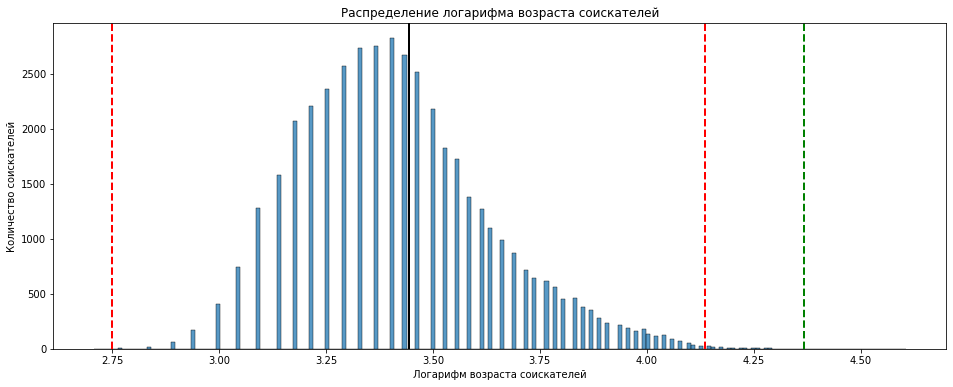

In [104]:
# ваш код здесь
# Отлично, я это уже делал когда исследовал распределение возраста. Показалось логичным.

fig, ax = plt.subplots(1, 1, figsize=(16, 6))
hh_data['Log Возраст'] = hh_data['Возраст'].apply(np.log)
log_data= hh_data['Log Возраст']
histplot = sns.histplot(log_data , bins=200)
histplot.axvline(log_data.mean(), color='k', lw=2)
histplot.axvline(log_data.mean()+ 3 * log_data.std(), color='r', ls='--', lw=2)
histplot.axvline(log_data.mean()- 3 * log_data.std(), color='r', ls='--', lw=2)
histplot.axvline(log_data.mean()+ 4 * log_data.std(), color='g', ls='--', lw=2)
histplot.set_title('Распределение логарифма возраста соискателей');
histplot.set_xlabel('Логарифм возраста соискателей');
histplot.set_ylabel('Количество соискателей');
print(f'Численный показатель асимметрии: {log_data.skew()}')

# вычислим выбросы с послаблением на сигму вправо
outliers = hh_data[(hh_data['Log Возраст'] > (log_data.mean()+ 4 * log_data.std())) | (hh_data['Log Возраст'] < (log_data.mean()- 3 * log_data.std()))]
display(outliers)
# удалим эти выбросы
hh_data = hh_data.drop(outliers.index, axis=0)
print(hh_data.shape)

Ассиметрия графика больше нуля, значит называется она правосторонней.
Черная линия - среднее. Красные пунктиры - границы по классическому методу 3х сигм. Зеленый пунктир - послабление еще на сигму справа.
Вывел таблицу с выбросами. Попали 2 резюме 15 лет и одно 100 лет. Всего 3.